In [1]:
%load_ext autoreload
%autoreload 2
import numpy as np
from matplotlib import pyplot as plt
from tqdm.notebook import tqdm

from mpsfm.test.simple import SimpleTest
from mpsfm.utils.tools import load_cfg
from mpsfm.vars import gvars


In [2]:
import os

if os.path.exists("/mpsfm/custom_dataset/cache_dir"):
    os.system(f"rm -rf /mpsfm/custom_dataset/cache_dir")

In [3]:
# select pipeline: mpsfm/sfm/configs
cname = "custom"
conf = load_cfg(gvars.SFM_CONFIG_DIR / f"{cname}.yaml", return_name=False)
#conf["extractors"]["matcher"] = "superpoint+lightglue"
#conf["extractors"]["depth"] = "metric3dv2-depth"
#conf["matches_mode"] = "sparse+depth"

In [4]:
print(conf)

{'matches_mode': 'sparse'}


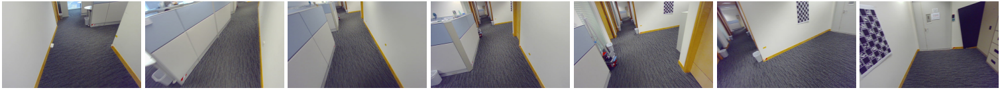

In [5]:
from mpsfm.utils.io import read_image
from mpsfm.utils.viz import plot_images, plot_keypoints
import pathlib

# example: 7 frames
data_dir = pathlib.Path("/mpsfm/custom_dataset") #gvars.ROOT / "local/example"
imanmes = sorted(list((data_dir / "images").iterdir()))
plot_images([read_image(imname) for imname in imanmes], dpi=30)
plt.show()
plt.close()

In [6]:
# setup the experiment
experiment = SimpleTest(conf, data_dir=data_dir)
# reconstruct
in_imanmes = [el.name for el in imanmes]
out_rec = experiment(
    imnames=in_imanmes,
    data_dir=data_dir,
)

	STARTING RECONSTRUCTION
Extracting netvlad retrieval features...


/usr/local/lib/python3.10/dist-packages/torch/cuda/__init__.py:789: UserWarning: Can't initialize NVML
  warnings.warn("Can't initialize NVML")


Loaded netvlad model.


100%|██████████| 7/7 [00:00<00:00,  9.47it/s]


Extracting retrieval pairs...
Extracting pairwise superpoint+lightglue information...
Loaded SuperPoint model
Loaded superpoint model.


100%|██████████| 7/7 [00:01<00:00,  5.33it/s]
/usr/local/lib/python3.10/dist-packages/lightglue/lightglue.py:24: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)


Loaded lightglue model.


100%|██████████| 21/21 [00:02<00:00,  9.36it/s]


Finished exporting matches.
Extracting metric3dv2 depth...


/usr/local/lib/python3.10/dist-packages/timm/models/layers/__init__.py:48: FutureWarning: Importing from timm.models.layers is deprecated, please import via timm.layers
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.layers", FutureWarning)
/usr/local/lib/python3.10/dist-packages/timm/models/registry.py:4: FutureWarning: Importing from timm.models.registry is deprecated, please import via timm.models
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.models", FutureWarning)
/usr/local/lib/python3.10/dist-packages/torch/cuda/__init__.py:789: UserWarning: Can't initialize NVML
  warnings.warn("Can't initialize NVML")
/mpsfm/third_party/Metric3D/mono/model/backbones/ViT_DINO.py:248: FutureWarning: xformers.components is deprecated and is not maintained anymore. It might be removed in a future version of xFormers 
  from xformers.components.attention import ScaledDotProduct
xFormers not available
xFormers not available


Loaded metric3dv2 model.


100%|██████████| 7/7 [00:09<00:00,  1.40s/it]


Extracting metric3dv2 normals...
Skipping the extraction.
Extracting ['sky'] masks...
Loaded skyseg model.


100%|██████████| 7/7 [00:05<00:00,  1.34it/s]

Estimating geometry and verifying matches...



100%|██████████| 21/21 [00:00<00:00, 778.45it/s]


Initializing camera integration data...


100%|██████████| 7/7 [00:00<00:00,  7.48it/s]


(5/7) Registering and Optimizing Image 2 140.png                                
AP estim Not enough inliers: 30
Failed to run post triangulation refinement
Failed to register and triangulate next image 2:140.png
(5/7) Registering and Optimizing Image 1 100.png                                
Depth consistency failed for 1: 0.25147642467860465!!!
Failed to run post triangulation refinement
(5/7) Registering and Optimizing Image 1 100.png                                
Depth consistency failed for 1: 0.2517550184039768!!!
Failed to run post triangulation refinement
(6/7) Registering and Optimizing Image 2 140.png                                
AP estim Not enough inliers: 30
Failed to run post triangulation refinement
Failed to register and triangulate next image 2:140.png
Halving AP inliers 1
(6/7) Registering and Optimizing Image 2 140.png                                
Ending mapper loop because all images are registered
(7/7) GLOBAL REFINEMENT                                     

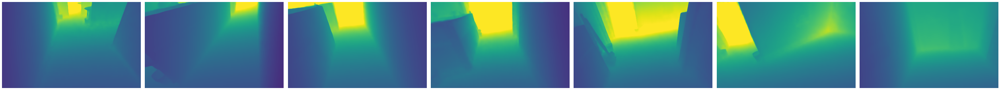

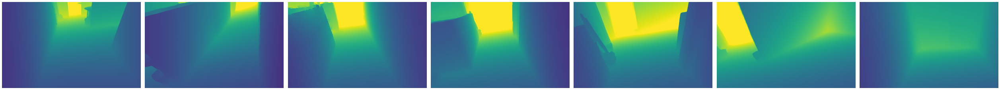

In [7]:
# Prior depths
p95 = np.percentile([image.depth.data for image in out_rec.images.values()], 95)
plot_images([image.depth.data_prior for image in out_rec.images.values()], dpi=50, cmaps="viridis", vmax=p95)
# Refined depths
plot_images([image.depth.data for image in out_rec.images.values()], dpi=50, cmaps="viridis", vmax=p95)
plt.show()
plt.close()

## Monocular Priors and Depth Refinement
To reconstruct challenging low-overlap scenes, we extend COLMAP using monocular surface priors. Monocular depth is used during absolute pose estimation and bundle adjustment to constrain low-overlap poses. To improve reconstruction quality, we refine the depth maps using normals and multi-view constraints. Below, we visualize the dense reconstruction of the scene, with the option to view both the rescaled prior depth maps and the refined depth maps.

In [8]:
fig = out_rec.vis_depth_maps(data_dir / "images", name="refined", dmap_rescale=0.8)
fig = out_rec.vis_depth_maps(fig=fig, images_dir=data_dir / "images", name="prior", prior=True, dmap_rescale=0.8)
fig = out_rec.vis_cameras(fig)
fig.show()

## COLMAP Points
**Covariances**: Our pipeline relies on COLMAP 3D points. We compute 3D point covariances to robustly constrain depth maps during normal integration. Below, we visualize the trace of these covariances.

**Sparse vs Dense Matches**: Our pipeline offers multiple options for leveraging dense matchers. In this example, we interpolate matches around SuperPoint keypoints to build reliable multi-view tracks in salient regions. To robustly constrain poses in low-overlap scenarios, we additionally sample matches in non-salient regions, building two-view-only tracks. We also visualize the corresponding masked 3D points.

In [9]:
# visualize sparse anchors (blue) and dense points (red)
sparse_dense_mode = "sparse_mask"
fig = out_rec.vis_colmap_points(mode=sparse_dense_mode, name=sparse_dense_mode)
uncertainty_mode = "uncert"
fig = out_rec.vis_colmap_points(fig=fig, mode=uncertainty_mode, name=uncertainty_mode)
fig = out_rec.vis_cameras(fig, color="green", name="cameras")
fig.show()

TypeError: 'NoneType' object is not subscriptable

Propagated uncertainties per pixel...


  0%|          | 0/7 [00:00<?, ?it/s]

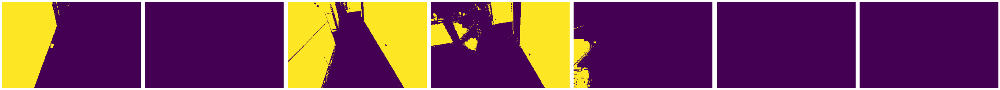

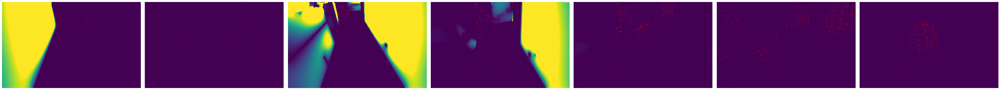

In [10]:
print("Propagated uncertainties per pixel...")
intstds = [image.calculate_int_covs_for_entire_image(False, False) for image in tqdm(out_rec.images.values())]
priorstds = [image.depth.uncertainty for image in out_rec.images.values()]

p90 = np.percentile(np.hstack(intstds), 90)

# Prior uncertainties
plot_images([std for std in priorstds], dpi=50, vmax=p90, cmaps="viridis")

# Propagated uncertainties
plot_images([std for std in intstds], dpi=50, vmax=p90, cmaps="viridis")
# Find 2D points used to optimize the depth
koords_with_3d = [image.keypoint_coords_with_3d() * image.camera.sx for image in out_rec.images.values()]
plot_keypoints(koords_with_3d, colors="r", ps=2)
plt.show()
plt.close()

In [11]:
p80 = np.percentile(np.hstack(intstds), 80)
intcov_masks = {imid: intstds < p80 for imid, intstds in zip(out_rec.images.keys(), intstds)}
fig = out_rec.vis_depth_maps(data_dir / "images", name="refined", input_masks=intcov_masks)
fig = out_rec.vis_cameras(fig)
fig.show()